In [2]:
# Initial imports
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

# Import json as per API documentation 
import json

%matplotlib inline

In [3]:
# Load .env enviroment variables
load_dotenv()

True

In [4]:
# Set Alpaca API key and secret
# YOUR CODE HERE!
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")
type(alpaca_api_key)

# Create the Alpaca API object
# YOUR CODE HERE!

alpaca_trade = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2"
)

In [5]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-08-07', tz='America/Chicago').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/Chicago').isoformat()

In [6]:
# Get 5 years' worth of historical data for SPY and AGG
# YOUR CODE HERE!

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

df_stock_data = alpaca_trade.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = end_date
).df

# Display sample data
df_stock_data.head()

AGG                                         SPY  \
                             open      high      low   close   volume    open   
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167  208.16   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778  209.28   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907  208.98   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979  207.11   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173  208.73   

                                                              
                             high     low   close     volume  
2015-08-07 00:00:00-04:00  208.34  206.87  207.93   87669782  
2015-08-10 00:00:00-04:00  210.67  209.28  210.58   66755890  
2015-08-11 00:00:00-04:00  209.47  207.76  208.63   88424557  
2015-08-12 00:00:00-04:00  209.14  205.36  208.89  136171450  
2015-08-13 00:00:00-04:00  209.55  208.01  208.63   77197796

In [7]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!
MCfive_year = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [0.6,0.4],
    num_simulation= 500,
    num_trading_days= 252*5
)
MCfive_year.portfolio_data.head()

AGG                                      \
                             open      high      low   close   volume   
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173   

                                           SPY                          \
                          daily_return    open    high     low   close   
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [8]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!
MCfive_year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.999690,0.997092,0.995735,1.002734,0.994837,1.000046,1.005291,0.994784,1.000082,1.009291,...,0.997107,1.006288,0.996148,0.997381,1.001328,1.001000,0.997645,0.999775,0.998626,1.002214
2,1.002496,1.001427,0.992732,0.999312,0.998937,0.998998,1.006493,0.993590,1.002639,1.008165,...,0.988683,1.011331,1.001331,0.999558,1.007122,0.997419,1.002023,0.987505,1.001307,1.000822
3,0.996884,0.998223,0.992617,0.996662,0.997232,1.006553,1.007123,0.999309,1.002277,1.011040,...,0.986280,1.018503,1.005604,1.003041,1.009549,0.990377,1.001796,1.000357,1.006622,1.004910
4,0.995589,1.001740,0.987803,0.990424,0.998368,1.008298,1.005534,0.993316,1.006064,1.011002,...,0.987699,1.012377,1.009400,0.996693,1.015029,0.983257,0.998959,0.996331,1.003030,1.000809
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.308015,1.354790,1.097675,1.503051,1.000700,1.086048,1.342223,1.214144,0.965530,1.588254,...,1.966023,1.368869,1.463496,1.165990,1.214853,1.210866,1.170755,1.263464,1.271556,1.300341
1257,1.302184,1.360041,1.101193,1.499388,1.009699,1.089488,1.353880,1.208520,0.963099,1.592531,...,1.975242,1.364489,1.457320,1.174940,1.224350,1.219179,1.173477,1.262090,1.273689,1.293514
1258,1.310810,1.362876,1.109411,1.492218,1.007668,1.088364,1.360278,1.197292,0.964121,1.598034,...,1.981824,1.374975,1.453644,1.162846,1.225220,1.221353,1.170364,1.259617,1.272234,1.302274
1259,1.314729,1.371006,1.103677,1.495848,1.013699,1.088879,1.360404,1.199755,0.967412,1.589657,...,1.983143,1.370720,1.459483,1.163155,1.218346,1.226159,1.172696,1.266983,1.267737,1.295876


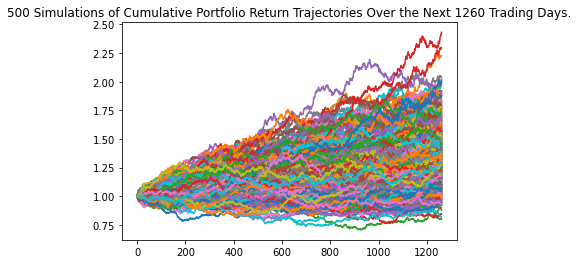

In [10]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot_five_y = MCfive_year.plot_simulation()

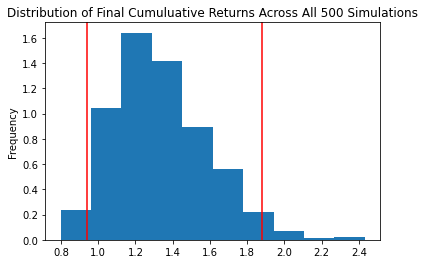

In [11]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
dist_plot_five_y = MCfive_year.plot_distribution()

In [12]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
fivey_summary_table = MCfive_year.summarize_cumulative_return()

# Print summary statistics
# YOUR CODE HERE!
print(fivey_summary_table)

count           500.000000
mean              1.336742
std               0.254957
min               0.797830
25%               1.157774
50%               1.304032
75%               1.488369
max               2.432100
95% CI Lower      0.940405
95% CI Upper      1.880715
Name: 1260, dtype: float64


In [13]:
# Set initial investment
# YOUR CODE HERE!
initial_investment = 20000 * 1.5 # from financial-planner.ipynb
five_ini_investment = 2*initial_investment

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!
fivey_ci_lower = round(fivey_summary_table[8]*five_ini_investment,2)
fivey_ci_upper = round(fivey_summary_table[9]*five_ini_investment,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${five_ini_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${fivey_ci_lower} and ${fivey_ci_upper}")

There is a 95% chance that an initial investment of $60000.0 in the portfolio over the next 5 years will end within in the range of $56424.31 and $112842.91


 Ten year Retirement Option

In [14]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!
MCten_year = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [0.6,0.4],
    num_simulation= 500,
    num_trading_days= 252*10
)
MCten_year.portfolio_data.head()

AGG                                      \
                             open      high      low   close   volume   
2015-08-07 00:00:00-04:00  109.14  109.2750  109.035  109.21  2041167   
2015-08-10 00:00:00-04:00  109.15  109.1700  108.920  109.06  1149778   
2015-08-11 00:00:00-04:00  109.42  109.5765  109.284  109.42  1420907   
2015-08-12 00:00:00-04:00  109.55  109.7100  109.350  109.36  1468979   
2015-08-13 00:00:00-04:00  109.36  109.3651  109.110  109.15  1465173   

                                           SPY                          \
                          daily_return    open    high     low   close   
2015-08-07 00:00:00-04:00          NaN  208.16  208.34  206.87  207.93   
2015-08-10 00:00:00-04:00    -0.001374  209.28  210.67  209.28  210.58   
2015-08-11 00:00:00-04:00     0.003301  208.98  209.47  207.76  208.63   
2015-08-12 00:00:00-04:00    -0.000548  207.11  209.14  205.36  208.89   
2015-08-13 00:00:00-04:00    -0.001920  208.73  209.55  208.01  208.63   

                                                   
                              volume daily_return  
2015-08-07 00:00:00-04:00   87669782          NaN  
2015-08-10 00:00:00-04:00   66755890     0.012745  
2015-08-11 00:00:00-04:00   88424557    -0.009260  
2015-08-12 00:00:00-04:00  136171450     0.001246  
2015-08-13 00:00:00-04:00   77197796    -0.001245

In [15]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!
MCten_year.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.001056,1.001615,0.994944,0.995672,1.006506,0.999969,1.000020,0.997354,1.000845,1.009256,...,1.009131,0.997912,0.998688,1.001566,0.987639,0.993646,1.005611,1.005004,0.995723,1.003529
2,0.995190,0.995008,0.997129,0.996612,1.008816,1.001765,0.997401,0.995968,1.012096,1.000772,...,1.014761,1.001580,0.992354,1.006194,0.985258,0.986067,1.002225,1.001001,0.994626,0.995770
3,0.994291,1.009042,1.001327,1.009551,1.004794,1.000237,0.998658,0.999841,1.019484,1.001761,...,1.018753,1.000648,0.993024,0.998458,0.977887,0.984258,0.997880,1.006924,0.991049,0.993698
4,0.995953,1.011503,0.997961,1.012299,1.003785,1.000078,0.994592,1.004114,1.020397,1.011905,...,1.021878,1.004681,0.990146,0.998271,0.973128,0.994049,0.994714,1.021194,0.996273,0.991863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.071149,2.154298,1.111273,2.644114,1.687893,1.753090,2.714044,3.122949,1.983696,1.482532,...,1.703602,0.912206,1.908123,1.540207,1.863897,1.463935,1.651057,2.169309,1.700931,1.410542
2517,2.058107,2.165886,1.104007,2.636539,1.699373,1.753298,2.712811,3.131840,1.975195,1.481786,...,1.704911,0.918384,1.896591,1.552942,1.863685,1.465116,1.638076,2.187823,1.696956,1.410116
2518,2.064048,2.166094,1.099121,2.637135,1.704175,1.737387,2.735826,3.134683,1.982240,1.472558,...,1.715851,0.918282,1.880232,1.565504,1.865363,1.457770,1.636489,2.195050,1.706545,1.409370
2519,2.070058,2.173045,1.105004,2.614068,1.686014,1.723212,2.714029,3.124716,1.998285,1.486349,...,1.716665,0.918399,1.890587,1.560414,1.855731,1.455852,1.631083,2.199168,1.711678,1.427353


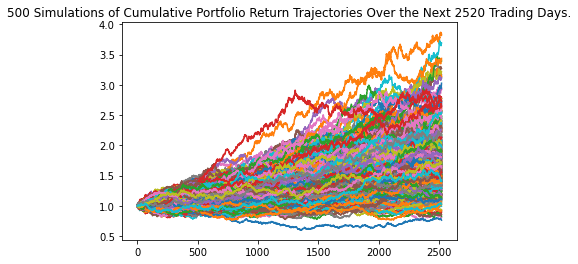

In [16]:
# Plot simulation outcomes
# YOUR CODE HERE!
line_plot_MCten_year=MCten_year.plot_simulation()

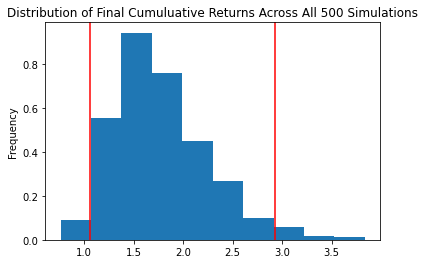

In [17]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!
dist_plot_MCten_year=MCten_year.plot_distribution()

In [18]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!
MCten_year_table = MCten_year.summarize_cumulative_return()

# Print summary statistics
# YOUR CODE HERE!
print(MCten_year_table)

count           500.000000
mean              1.769038
std               0.484483
min               0.761273
25%               1.433532
50%               1.695986
75%               2.026190
max               3.836085
95% CI Lower      1.063052
95% CI Upper      2.930402
Name: 2520, dtype: float64


In [19]:
# Set initial investment
# YOUR CODE HERE!
initial_investment= five_ini_investment

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!
ci_lower_ten = round(MCten_year_table[8]*initial_investment,2)
ci_upper_ten = round(MCten_year_table[9]*initial_investment,2) 
# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000.0 in the portfolio over the next 10 years will end within in the range of $63783.11 and $175824.13
